# Import packages

In [1]:
import numpy as np
import matplotlib.image as mpimg
import matplotlib.pyplot as plt
import cv2
import glob
from PIL import Image
from PIL import ImageFont
from PIL import ImageDraw
%matplotlib inline

# Camera Calibration

In [2]:
images = glob.glob('./camera_cal/calibration*.jpg')
#plt.imshow(img)

obj_points = [] # 3D real points
img_points = [] # 2D image points

# prepare points
objp = np.zeros((6*9,3), np.float32)
objp[:,:2] = np.mgrid[0:9,0:6].T.reshape(-1,2)

i = 0
for fname in images:
    img = mpimg.imread(fname)
    
    # convert to grayscale
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    #plt.imshow(gray, cmap='gray')

    # find chessboard corners
    ret, corners = cv2.findChessboardCorners(gray, (9,6), None)

    if ret == True:
        i += 1
        img_points.append(corners)
        obj_points.append(objp)

        # draw chessboard corners
        img = cv2.drawChessboardCorners(img, (9,6), corners, ret)
        #plt.figure();
        #plt.imshow(img)

        
# calibrate Camera
ret, mtx, dist, rvecs, tvecs = cv2.calibrateCamera(obj_points, img_points, gray.shape[::-1], None, None)

# Undistort Images

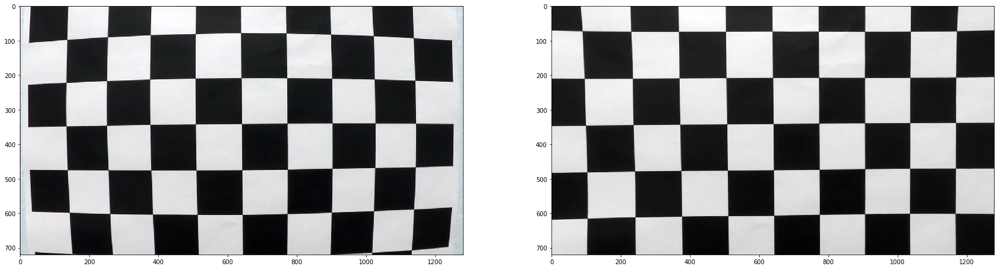

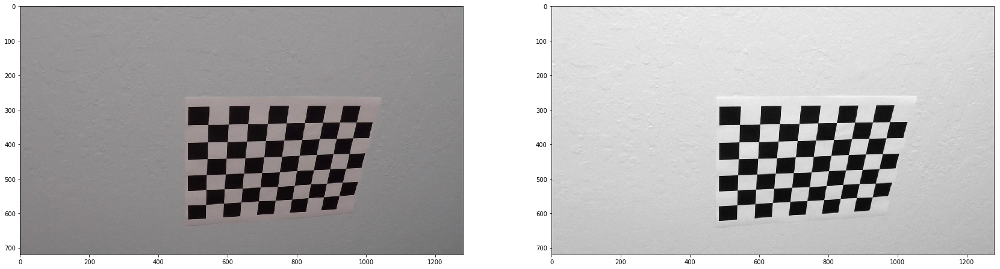

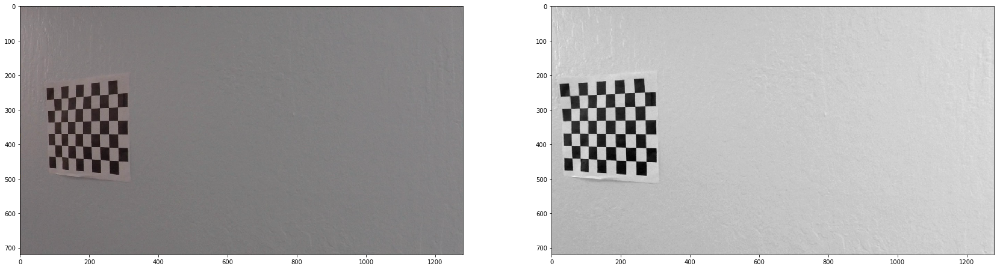

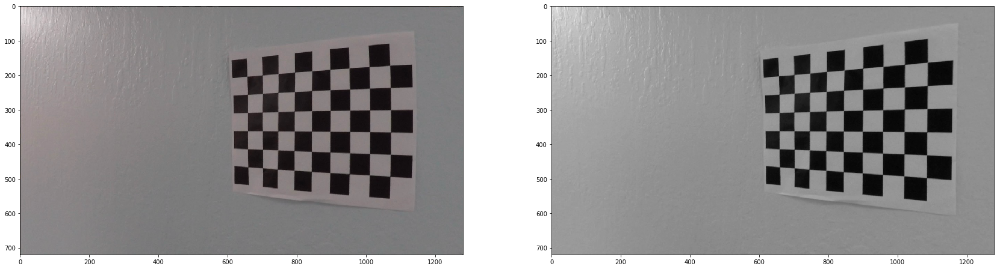

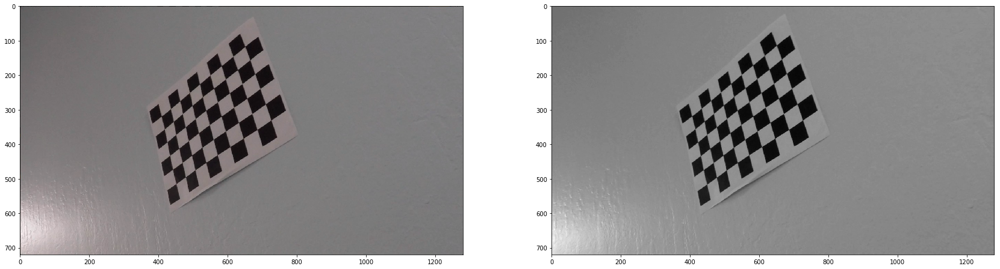

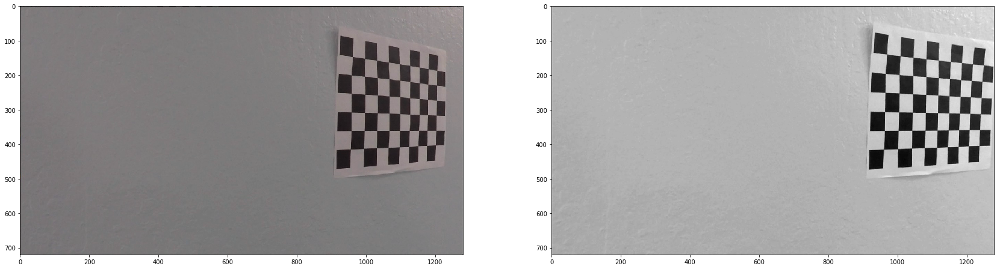

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.


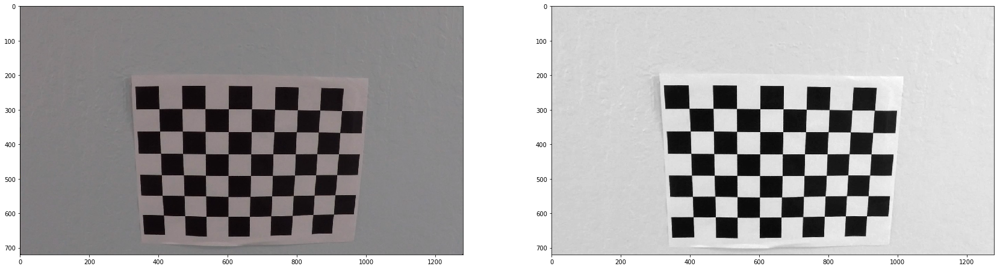

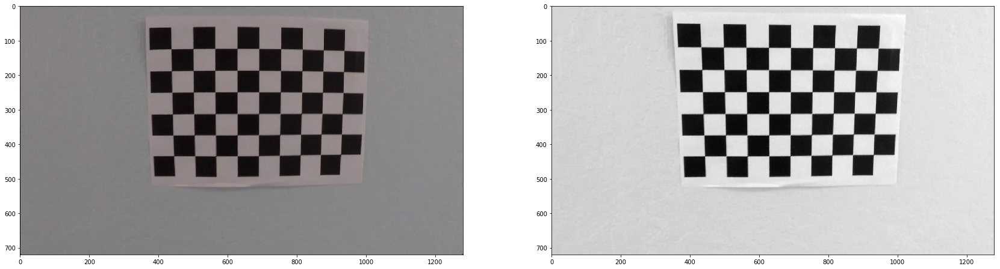

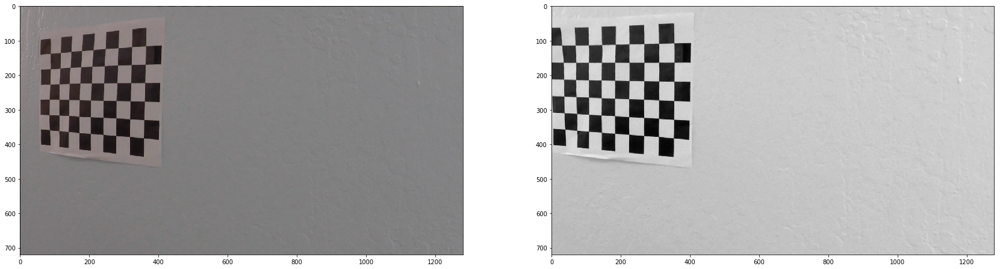

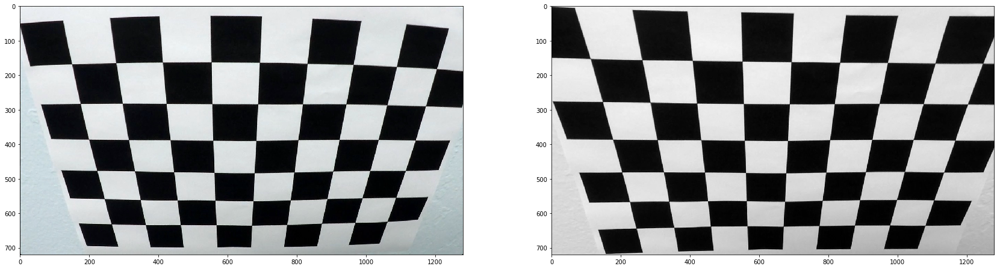

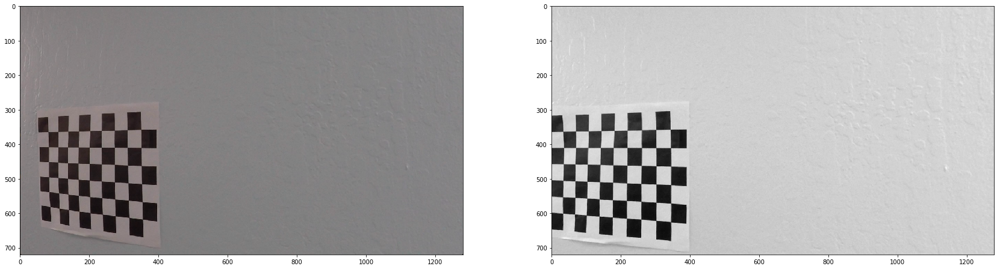

...

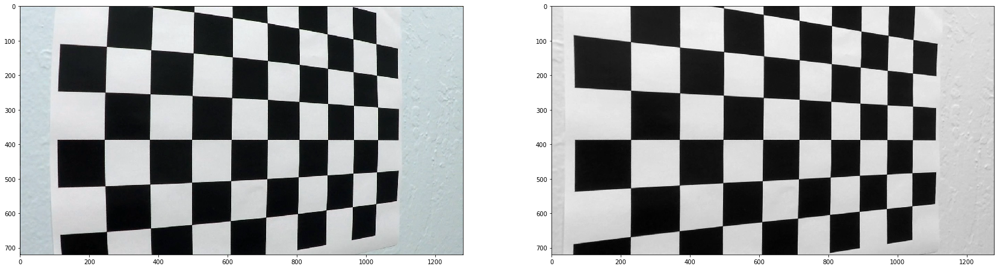

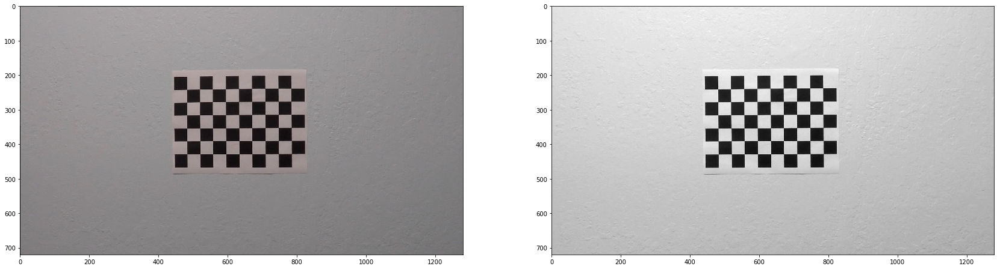

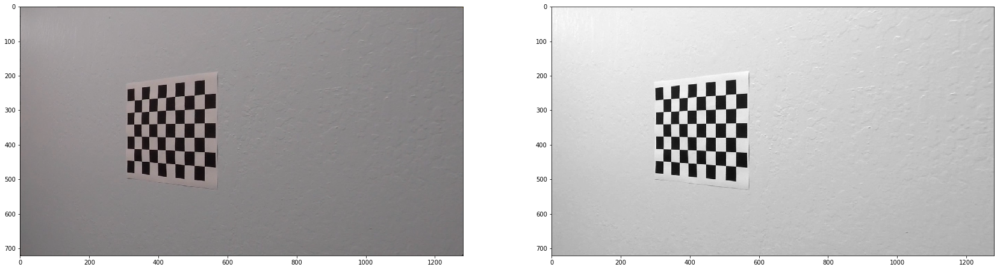

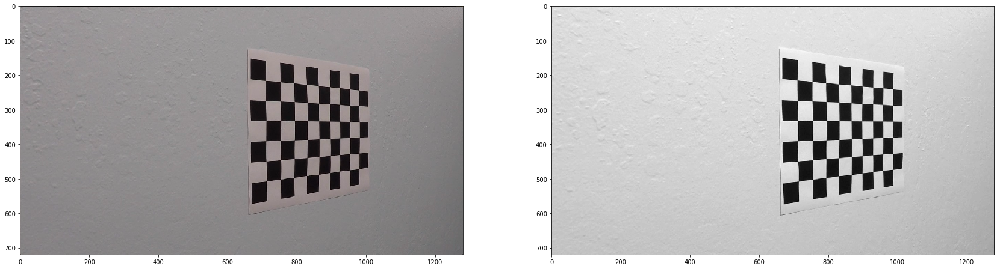

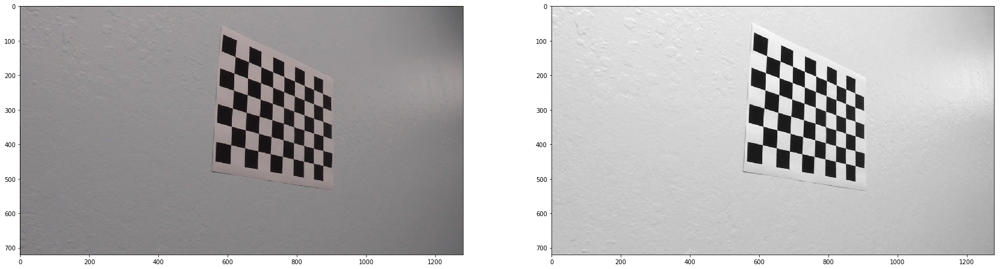

In [104]:
# undistort images

count = 0
for file in images:
    undist_img = cv2.imread(file)
    undist_gray = cv2.cvtColor(undist_img, cv2.COLOR_BGR2GRAY)
    dst = cv2.undistort(undist_gray, mtx, dist, None, mtx)
    #subfig[count % 4, count // 4].imshow(dst, cmap='gray')
    #count += 1
    fig, subfig = plt.subplots(1,2, figsize=(29,9))
    subfig[0].imshow(undist_img,cmap='gray')
    subfig[1].imshow(dst, cmap='gray')

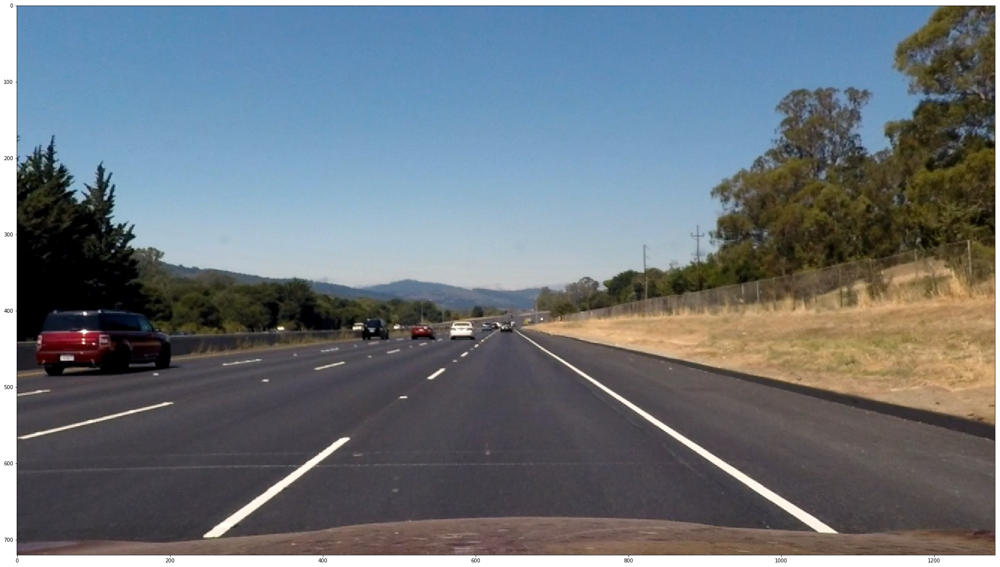

In [114]:
img = mpimg.imread('./test_images/straight_lines2.jpg')
undist = cv2.undistort(img, mtx, dist, None, mtx)

plt.figure(figsize=(60,20))
plt.imshow(undist)


# Define some useful operators

In [3]:
def sobel(img, direction='x', thresh_min=0, thresh_max=255, kernel_size=3, input_gray='no'):
    if input_gray == 'no':
        s_gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    else:
        s_gray = img
    sobelx = cv2.Sobel(s_gray, cv2.CV_64F, 1, 0, ksize = kernel_size)
    sobely = cv2.Sobel(s_gray, cv2.CV_64F, 0, 1, ksize = kernel_size)
    
    abs_sobelx = np.absolute(sobelx)
    abs_sobely = np.absolute(sobely)
    
    scaled_sobelx = np.uint8(255*abs_sobelx/np.max(abs_sobelx))
    scaled_sobely = np.uint8(255*abs_sobely/np.max(abs_sobely))
    
    sobel_binary = np.zeros_like(scaled_sobelx)
    
    if direction == 'x':
        sobel_binary[(scaled_sobelx>=thresh_min) & (scaled_sobelx<=thresh_max)] = 1
    elif direction == 'y': 
        sobel_binary[(scaled_sobely>=thresh_min) & (scaled_sobely<=thresh_max)] = 1
    else:
        print('Infeasible direction! Choose x or y!')
        
    return sobel_binary



def mag_thresh(img, kernel_size=3, mag_thresh=(0,255), input_gray = 'no'):
    if input_gray == 'no':
        s_gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    else:
        s_gray = img
    
    sobelx = cv2.Sobel(s_gray, cv2.CV_64F, 1, 0, ksize = kernel_size)
    sobely = cv2.Sobel(s_gray, cv2.CV_64F, 0, 1, ksize = kernel_size)
    
    mag = np.sqrt(sobelx**2 + sobely**2)
    
    scaled_mag = np.uint8(255*mag/np.max(mag))
    
    binary_output = np.zeros_like(s_gray)
    
    binary_output[(scaled_mag >= mag_thresh[0]) & (scaled_mag <= mag_thresh[1])] = 1
    
    return np.round(binary_output)



def dir_threshold(img, sobel_kernel=3, thresh=(0,np.pi/2), input_gray='no'):
    if input_gray == 'no':
        s_gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    else:
        s_gray = img
    
    sobelx = cv2.Sobel(s_gray, cv2.CV_64F, 1, 0, ksize = sobel_kernel)
    sobely = cv2.Sobel(s_gray, cv2.CV_64F, 0, 1, ksize = sobel_kernel)
    
    direc = np.arctan2(np.absolute(sobely), np.absolute(sobelx))
    
    binary_output = np.zeros_like(s_gray)
    binary_output[(direc >= thresh[0]) & (direc <= thresh[1])] = 1
    
    return binary_output

# Perspective Transform

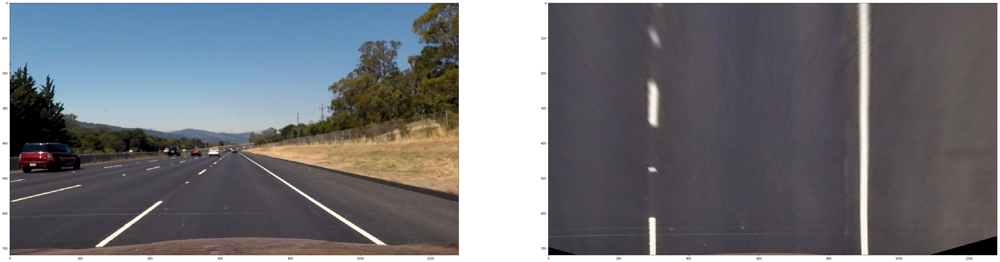

In [4]:
img_straight_linesO = mpimg.imread('./test_images/straight_lines2.jpg')

img_straight_lines = cv2.undistort(img_straight_linesO, mtx, dist, None, mtx)

img_size = (img_straight_lines.shape[1], img_straight_lines.shape[0])

# long
# lower_left = [280, 678]
# lower_right = [1040, 678]
# upper_right = [685, 447]
# upper_left = [601,447]

# short
# lower_left = [280, 678]
# lower_right = [1040, 678]
# upper_right = [772,502]
# upper_left = [521,502]

lower_left = [280, 678]
lower_right = [1040, 678]
upper_right = [705,460]
upper_left = [580,460]

src = np.float32([lower_left, lower_right, upper_right, upper_left])
dst = np.float32([ [300,719], [900,719], [900,0], [300,0] ])

M = cv2.getPerspectiveTransform(src,dst)
Minv = cv2.getPerspectiveTransform(dst,src)

warped = cv2.warpPerspective(img_straight_lines, M, img_size, flags=cv2.INTER_LINEAR)
warpedO = cv2.warpPerspective(img_straight_linesO, M, img_size, flags=cv2.INTER_LINEAR)

# plt.figure()
# plt.imshow(img_straight_linesO)
# plt.figure()
# plt.imshow(warpedO)
# plt.figure()
# plt.imshow(img_straight_lines)
# plt.figure()
# plt.imshow(warped)

backwarp = cv2.warpPerspective(warped, Minv, img_size, flags=cv2.INTER_LINEAR)
# plt.figure()
# plt.imshow(backwarp)


# Now some operators are applied to the warped image. Uncomment figures to see.
R = warped[:,:,0]
hls = cv2.cvtColor(warped,cv2.COLOR_RGB2HLS)
S = hls[:,:,2]

combined = np.zeros_like(R)
combined[(S >= 180) | (R >= 180)] = 1

warped_gray = cv2.cvtColor(warped, cv2.COLOR_RGB2GRAY)
grad = sobel(warped_gray, 'x', 7, 255, 3, 'yes') #sobel(img, direction='x', thresh_min=0, thresh_max=255, kernel_size=3):

combined2 = np.zeros_like(R)
combined2[(S>=180) | (R>=180) | (grad == 1)] = 1

dir_binary = dir_threshold(warped_gray, sobel_kernel=3, thresh=(0,np.pi/2), input_gray='yes')
mag_binary = mag_thresh(warped_gray, 3, mag_thresh=(10,255), input_gray='yes')

combined3 = np.zeros_like(R)
combined3[(S>=180) | (R>=180) | (mag_binary == 1)] = 1

median = cv2.medianBlur(combined3,9)

# fig2, subfig2 = plt.subplots(4,2,figsize=(50,50))
# subfig2[0,0].imshow(S,cmap='gray')
# subfig2[0,1].imshow(R,cmap='gray')
# subfig2[1,0].imshow(combined, cmap='gray')
# subfig2[1,1].imshow(grad, cmap='gray')
# subfig2[2,0].imshow(combined2, cmap='gray')
# subfig2[2,1].imshow(mag_binary, cmap='gray')
# subfig2[3,0].imshow(combined3, cmap='gray')
# subfig2[3,1].imshow(median, cmap='gray')
fig, subfig = plt.subplots(1,2, figsize=(60,20))
subfig[0].imshow(img_straight_lines)
subfig[1].imshow(warped)

# Some useful functions

In [5]:
def histo(img):
    histogram = np.sum(img[img.shape[0]//2:,:], axis=0)
    #histogram = np.sum(img, axis=0)
    plt.figure()
    plt.plot(histogram)
    
def calc_curvature(left_fit, right_fit, y_eval = 719):
    left_curverad = ((1 + (2*left_fit[0]*y_eval + left_fit[1])**2)**1.5) / np.absolute(2*left_fit[0])
    right_curverad = ((1 + (2*right_fit[0]*y_eval + right_fit[1])**2)**1.5) / np.absolute(2*right_fit[0])
    return left_curverad, right_curverad

def calc_curvature2(leftx, rightx, y_eval = 719):
    ym_per_pix = 30/720 # meters per pixel in y dimension
    xm_per_pix = 3.7/700 # meters per pixel in x dimension
    # Fit new polynomials to x,y in world space
    ploty = np.linspace(0,719,720)
    left_fit_cr = np.polyfit(ploty*ym_per_pix, leftx*xm_per_pix, 2)
    right_fit_cr = np.polyfit(ploty*ym_per_pix, rightx*xm_per_pix, 2)
    # Calculate the new radii of curvature
    left_curverad = ((1 + (2*left_fit_cr[0]*y_eval*ym_per_pix + left_fit_cr[1])**2)**1.5) / np.absolute(2*left_fit_cr[0])
    right_curverad = ((1 + (2*right_fit_cr[0]*y_eval*ym_per_pix + right_fit_cr[1])**2)**1.5) / np.absolute(2*right_fit_cr[0])
    # Now our radius of curvature is in meters
    return left_curverad, right_curverad

def region_of_interest(img, vertices):
    """
    Applies an image mask.
    
    Only keeps the region of the image defined by the polygon
    formed from `vertices`. The rest of the image is set to black.
    """
    #defining a blank mask to start with
    mask = np.zeros_like(img)   
    
    #defining a 3 channel or 1 channel color to fill the mask with depending on the input image
    if len(img.shape) > 2:
        channel_count = img.shape[2]  # i.e. 3 or 4 depending on your image
        ignore_mask_color = (255,) * channel_count
    else:
        ignore_mask_color = 255
        
    #filling pixels inside the polygon defined by "vertices" with the fill color    
    cv2.fillPoly(mask, vertices, ignore_mask_color)
    
    #returning the image only where mask pixels are nonzero
    masked_image = cv2.bitwise_and(img, mask)
    return masked_image

# Project pipeline on Images

In [6]:
# project lines on the original image

def project_on_lines(img, undist, pipe, left_fitx, right_fitx, ploty, org, say, safe_lines_x):

    warped = pipe
    image = img

    # Create an image to draw the lines on
    warp_zero = np.zeros_like(warped).astype(np.uint8)
    color_warp = np.dstack((warp_zero, warp_zero, warp_zero))

    # Recast the x and y points into usable format for cv2.fillPoly()
    pts_left = np.array([np.transpose(np.vstack([left_fitx, ploty]))])
    pts_right = np.array([np.flipud(np.transpose(np.vstack([right_fitx, ploty])))])
    pts = np.hstack((pts_left, pts_right))

    # Draw the lane onto the warped blank image
    cv2.fillPoly(color_warp, np.int_([pts]), (0,255, 0))
    if say == 'yes':
        cv2.circle(color_warp, (int(org[0]), 719), 15, (255,0,0), thickness=25)
        cv2.circle(color_warp, (int(org[1]), 719), 15, (255,0,0), thickness=25)
        #cv2.circle(color_warp, (int(start_center[0]), 719), 10, (255,255,255), thickness=25)
        #cv2.circle(color_warp, (int(start_center[1]), 719), 10, (255,255,255), thickness=25)
        ploty = np.linspace(0,719,720)
        for safe_line in safe_lines_x:
            pts = np.dstack((safe_line, ploty))
            cv2.polylines(color_warp, pts.astype(int), isClosed=False, color=(255,0,0), thickness=3)

        pts = np.dstack((left_fitx, ploty))
        cv2.polylines(color_warp, pts.astype(int), isClosed=False, color=(0,0,255), thickness=15)
        pts = np.dstack((right_fitx, ploty))
        cv2.polylines(color_warp, pts.astype(int), isClosed=False, color=(0,0,255), thickness=15)
            
#     plt.figure(figsize=(60,20))
#     plt.imshow(color_warp)

    # Warp the blank back to original image space using inverse perspective matrix (Minv)
    newwarp = cv2.warpPerspective(color_warp, Minv, (image.shape[1], image.shape[0])) 
    # Combine the result with the original image
    result = cv2.addWeighted(undist, 1, newwarp, 0.3, 0)
    #plt.figure(figsize=(60,20))
    #plt.imshow(result)
    #plt.imshow(result)
    return result

# Sliding Window and Window Centroid Function

In [9]:
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import glob
import cv2

# Read in a thresholded image
#warped = mpimg.imread('warped_example.jpg')
# window settings

#window_width = 50 
#window_height = 60#120 # Break image into 9 vertical layers since image height is 720
#margin = 100 # How much to slide left and right for searching
window_width = 50 
window_height = 60 # Break image into 9 vertical layers since image height is 720
margin = 50
org_center = (0,0)

warped = mag_thresh(gray, 3, mag_thresh=(40,255), input_gray='yes')


def window_mask(width, height, img_ref, center,level):
    output = np.zeros_like(img_ref)
    output[int(img_ref.shape[0]-(level+1)*height):int(img_ref.shape[0]-level*height),max(0,int(center-width/2)):min(int(center+width/2),img_ref.shape[1])] = 1   
    return output

def find_window_centroids(warped, window_width, window_height, margin, say='no'):
    #global org_center
    window_centroids = [] # Store the (left,right) window centroid positions per level
    window = np.ones(window_width) # Create our window template that we will use for convolutions
    
    # First find the two starting positions for the left and right lane by using np.sum to get the vertical image slice
    # and then np.convolve the vertical image slice with the window template 
    
    # Sum quarter bottom of image to get slice, could use a different ratio
    l_sum = np.sum(warped[int(3*warped.shape[0]/4):,:int(warped.shape[1]/2)], axis=0)
    l_center = np.argmax(np.convolve(window,l_sum))-window_width/2
    r_sum = np.sum(warped[int(3*warped.shape[0]/4):,int(warped.shape[1]/2):], axis=0)
    r_center = np.argmax(np.convolve(window,r_sum))-window_width/2+int(warped.shape[1]/2)
    
    # Add what we found for the first layer
    
    if say == 'no':
        if org_center[0] == 0:
            window_centroids.append((l_center,r_center))
        else:
            l_center = org_center[0]
            r_center = org_center[1]
            window_centroids.append((l_center,r_center))
    elif say == 'yes':
        window_centroids.append((l_center,r_center))
    
    # Go through each layer looking for max pixel locations
    for level in range(1,(int)(warped.shape[0]/window_height)):
	    # convolve the window into the vertical slice of the image
        
        image_layer = np.sum(warped[int(warped.shape[0]-(level+1)*window_height):int(warped.shape[0]-level*window_height),:], axis=0)
        conv_signal = np.convolve(window, image_layer)
        
	    # Find the best left centroid by using past left center as a reference
	    # Use window_width/2 as offset because convolution signal reference is at right side of window, not center of window
        offset = window_width/2
        l_min_index = int(max(l_center+offset-margin,0))
        l_max_index = int(min(l_center+offset+margin,warped.shape[1]))
        l_center = np.argmax(conv_signal[l_min_index:l_max_index])+l_min_index-offset
	    # Find the best right centroid by using past right center as a reference
        r_min_index = int(max(r_center+offset-margin,0))
        r_max_index = int(min(r_center+offset+margin,warped.shape[1]))
        r_center = np.argmax(conv_signal[r_min_index:r_max_index])+r_min_index-offset
	    # Add what we found for that layer
        window_centroids.append((l_center,r_center))
        #SIG.append(np.sum(np.sum(warped[l_min_index: l_max_index, r_min_index:r_max_index])))

    return window_centroids


window_centroids = find_window_centroids(warped, window_width, window_height, margin)

# If we found any window centers
def plot_window(warped, window_centroids):
    if len(window_centroids) > 0:

        # Points used to draw all the left and right windows
        l_points = np.zeros_like(warped)
        r_points = np.zeros_like(warped)

        # Go through each level and draw the windows 	
        for level in range(0,len(window_centroids)):
            # Window_mask is a function to draw window areas
            l_mask = window_mask(window_width,window_height,warped,window_centroids[level][0],level)
            r_mask = window_mask(window_width,window_height,warped,window_centroids[level][1],level)
            # Add graphic points from window mask here to total pixels found 
            l_points[(l_points == 255) | ((l_mask == 1) ) ] = 255
            r_points[(r_points == 255) | ((r_mask == 1) ) ] = 255

        # Draw the results
        template = np.array(r_points+l_points,np.uint8) # add both left and right window pixels together
        zero_channel = np.zeros_like(template) # create a zero color channel
        template = np.array(cv2.merge((zero_channel,template,zero_channel)),np.uint8) # make window pixels green
        warpage = np.array(cv2.merge((warped,warped,warped)),np.uint8) # making the original road pixels 3 color channels
        output = cv2.addWeighted(warpage, 1, template, 0.5, 0.0) # overlay the orignal road image with window results

    # If no window centers found, just display orginal road image
    else:
        output = np.array(cv2.merge((warped,warped,warped)),np.uint8)

    # Display the final results
#     plt.imshow(output)
#     plt.title('window fitting results')
#     plt.show()
    return output



def plot_trusted(warped, window_centroids):
    if len(window_centroids) > 0:

        # Points used to draw all the left and right windows
        l_points = np.zeros_like(warped)
        #r_points = np.zeros_like(warped)

        # Go through each level and draw the windows 	
        for ite in range(0,len(window_centroids)):
            # Window_mask is a function to draw window areas
            level = window_centroids[ite][0]
            l_mask = window_mask(window_width,window_height,warped,window_centroids[ite][1],level)
            #r_mask = window_mask(window_width,window_height,warped,window_centroids[level][1],level)
            # Add graphic points from window mask here to total pixels found 
            l_points[(l_points == 255) | ((l_mask == 1) ) ] = 255
            #r_points[(r_points == 255) | ((r_mask == 1) ) ] = 255

        # Draw the results
        template = np.array(l_points,np.uint8) # add both left and right window pixels together
        zero_channel = np.zeros_like(template) # create a zero color channel
        template = np.array(cv2.merge((zero_channel,template,zero_channel)),np.uint8) # make window pixels green
        warpage = np.array(cv2.merge((warped,warped,warped)),np.uint8) # making the original road pixels 3 color channels
        output = cv2.addWeighted(warpage, 1, template, 0.5, 0.0) # overlay the orignal road image with window results

    # If no window centers found, just display orginal road image
    else:
        output = np.array(cv2.merge((warped,warped,warped)),np.uint8)

    # Display the final results
#     plt.imshow(output)
#     plt.title('window fitting results')
#     plt.show()
    return output   


# Sliding windows

def sliding_windows(binary_warped):
    # Assuming you have created a warped binary image called "binary_warped"
    # Take a histogram of the bottom half of the image
    histogram = np.sum(binary_warped[binary_warped.shape[0]//2:,:], axis=0)
    # Create an output image to draw on and  visualize the result
    out_img = np.dstack((binary_warped, binary_warped, binary_warped))*255
    # Find the peak of the left and right halves of the histogram
    # These will be the starting point for the left and right lines
    midpoint = np.int(histogram.shape[0]//2)
    leftx_base = np.argmax(histogram[:midpoint])
    rightx_base = np.argmax(histogram[midpoint:]) + midpoint

    # Choose the number of sliding windows
    nwindows = 9
    # Set height of windows
    window_height = np.int(binary_warped.shape[0]/nwindows)
    # Identify the x and y positions of all nonzero pixels in the image
    nonzero = binary_warped.nonzero()
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])
    # Current positions to be updated for each window
    leftx_current = leftx_base
    rightx_current = rightx_base
    # Set the width of the windows +/- margin
    margin = 100
    # Set minimum number of pixels found to recenter window
    minpix = 50
    # Create empty lists to receive left and right lane pixel indices
    left_lane_inds = []
    right_lane_inds = []
    
    # Step through the windows one by one
    for window in range(nwindows):
        # Identify window boundaries in x and y (and right and left)
        win_y_low = binary_warped.shape[0] - (window+1)*window_height
        win_y_high = binary_warped.shape[0] - window*window_height
        win_xleft_low = leftx_current - margin
        win_xleft_high = leftx_current + margin
        win_xright_low = rightx_current - margin
        win_xright_high = rightx_current + margin
        # Draw the windows on the visualization image
        cv2.rectangle(out_img,(win_xleft_low,win_y_low),(win_xleft_high,win_y_high),
        (0,255,0), 2) 
        cv2.rectangle(out_img,(win_xright_low,win_y_low),(win_xright_high,win_y_high),
        (0,255,0), 2) 
        # Identify the nonzero pixels in x and y within the window
        good_left_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & 
        (nonzerox >= win_xleft_low) &  (nonzerox < win_xleft_high)).nonzero()[0]
        good_right_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & 
        (nonzerox >= win_xright_low) &  (nonzerox < win_xright_high)).nonzero()[0]
        # Append these indices to the lists
        left_lane_inds.append(good_left_inds)
        right_lane_inds.append(good_right_inds)
        # If you found > minpix pixels, recenter next window on their mean position
        if len(good_left_inds) > minpix:
            leftx_current = np.int(np.mean(nonzerox[good_left_inds]))
        if len(good_right_inds) > minpix:        
            rightx_current = np.int(np.mean(nonzerox[good_right_inds]))

    # Concatenate the arrays of indices
    left_lane_inds = np.concatenate(left_lane_inds)
    right_lane_inds = np.concatenate(right_lane_inds)

    # Extract left and right line pixel positions
    leftx = nonzerox[left_lane_inds]
    lefty = nonzeroy[left_lane_inds] 
    rightx = nonzerox[right_lane_inds]
    righty = nonzeroy[right_lane_inds] 
    
#     pts_x = []
#     pts_y = []
#     for i in range(720):
#         pts_x.append(rightx[i])
#         pts_y.append(righty[i])
#         pts_x.append(leftx[i])
#         pts_y.append(lefty[i])
#     A = np.zeros_like(out_img)
#     plt.figure()
#     plt.imshow(A)
#     plt.plot(pts_x,pts_y, 'x')

    
    # Fit a second order polynomial to each
#     weights1 = np.zeros_like(lefty)
#     weights2 = np.zeros_like(righty)
#     S1 = weights1.size
#     S2 = weights2.size
   # weights1[0] = 20
    #weights2[0] = 20
#     leftmin = np.min(lefty)
#     rightmin = np.min(righty)
#     for i in range(0,S1):
#         #weights1[i] = 2 - 1/(S1-1)  
#         weights1[i] = lefty[i]-leftmin
#     for i in range(0,S2):
#         #weights2[i] = 2 - 1/(S2-1)
#         weights2[i] = righty[i] - rightmin
    
#    left_fit = np.polyfit(lefty, leftx, 2, w=weights1)
#    right_fit = np.polyfit(righty, rightx, 2, w=weights2)
    
    left_fit = np.polyfit(lefty,leftx,2)
    right_fit = np.polyfit(righty,rightx,2)
    
    return left_fit, right_fit, out_img, nonzerox, nonzeroy, left_lane_inds, right_lane_inds

# My Pipeline

In [20]:
def pipeline2(img):
    global my_left_fit, my_right_fit
    global trust_l, trust_r
    global iteration
    global belief_hist
    global org_center, org_hist
    global left_coef, right_coef
    global belief_left, belief_right
    
    img = cv2.undistort(img, mtx, dist, None, mtx)
    undistorted_img = img
    
    #RoI = np.array([[[50,719],[1200,719],[900,440],[500,440]]])
    #img = region_of_interest(img, RoI)

    X_0 = cv2.warpPerspective(img, M, img_size, flags=cv2.INTER_LINEAR)
    gray = cv2.cvtColor(X_0, cv2.COLOR_RGB2GRAY)
    # only area around old line:

    #plt.figure()
   # plt.imshow(X)
    
    if iteration > 2:
        s1 = safe_lines_x[0] #left_l
        s2 = safe_lines_x[1] #left_r
        s3 = safe_lines_x[2] #right_l
        s4 = safe_lines_x[3] #right_r


        s = []
        for i in range(720):
            s.append([int(s1[719-i]), 719-i])
            #plt.plot(int(s1[719-i]), 719-i, 'r.')
        for i in range(720):
            s.append([int(s2[i]), i])
            #plt.plot(int(s2[i]), i, 'b.')
        X1 = region_of_interest(X_0, np.array([s]))

        s = []
        for i in range(720):
            s.append([int(s3[719-i]), 719-i])
            #plt.plot(int(s3[719-i]), 719-i, 'g.')
        for i in range(720):
            s.append([int(s4[i]), i])
            #plt.plot(int(s4[i]), i, 'y.')
        X2 = region_of_interest(X_0, np.array([s]))
        X = np.maximum(X1,X2)
        plt.figure(figsize=(60,20))
        plt.imshow(X)
    else:
        X = X_0
   # plt.figure()
   # plt.imshow(X)


    window_width = 50 
    window_height = 60 # Break image into 9 vertical layers since image height is 720
    margin = 50

    hls = cv2.cvtColor(X, cv2.COLOR_RGB2HLS)
    
    if iteration > 2:
        s = []
        for i in range(720):
            s.append([int(s1[719-i]), 719-i])
            #plt.plot(int(s1[719-i]), 719-i, 'r.')
        for i in range(720):
            s.append([int(s2[i]), i])
            #plt.plot(int(s2[i]), i, 'b.')
        hls1 = region_of_interest(hls, np.array([s]))

        s = []
        for i in range(720):
            s.append([int(s3[719-i]), 719-i])
            #plt.plot(int(s3[719-i]), 719-i, 'g.')
        for i in range(720):
            s.append([int(s4[i]), i])
            #plt.plot(int(s4[i]), i, 'y.')
        hls2 = region_of_interest(hls, np.array([s]))
        hls = np.maximum(hls1,hls2)    
    
    
    
#     plt.figure()
#     plt.imshow(hls)
    S = hls[:,:,2]
    R = X[:,:,0]
#     plt.figure()
#     plt.imshow(S)

    f1 = np.zeros_like(R)
    f2 = np.zeros_like(R)
    f3 = np.zeros_like(R)
    f4 = np.zeros_like(R)
    f5 = np.zeros_like(R)
    f5_2 = np.zeros_like(R)
    f5_3 = np.zeros_like(R)
    f5_4 = np.zeros_like(R)
    f6 = np.zeros_like(R)

    #f1[S>=150]   = 1
    #f2[R >= 150] = 1
    f3_0 = mag_thresh(X, 3, mag_thresh=(10,255), input_gray='no')
    f3 = mag_thresh(X, 3, mag_thresh=(10,255), input_gray='no')
    f4 = sobel(X, 'x', 7, 255, 3, 'no')

    f5[(S>=220) | (R>=220)| (gray>=165)] = 1
    f5_2[(S>=180) | (R>=180)| (gray>=165)] = 1
    f5_3[(S>=165) | (R>=165) | (gray>=165)] = 1
    f5_4[(S>=165) | (R>=165) | (gray>=165) | (f3_0 == 1)] = 1
    f6[(S>=220) | (R>=220) | (f3==1) | (f4==1)| (gray>=165)] = 1

    
    f3 = cv2.medianBlur(f3, 15)
    f4 = cv2.medianBlur(f4, 15)
    f5 = cv2.medianBlur(f5, 15)
    f5_2 = cv2.medianBlur(f5_2, 15)
    f5_3 = cv2.medianBlur(f5_2, 15)
    f5_4 = cv2.medianBlur(f5_2, 15)
    f6 = cv2.medianBlur(f6, 15)

    features_raw = [f5, f5_2,f5_3, f5_4, f3, f4, f6]

    features = []
    for feat in features_raw:
        #plt.figure()
        #plt.imshow(feat, cmap='gray')
       # print(np.sum(feat))
        if iteration > 2:
            if np.sum(feat) >= 5000:
                features.append(feat)
        else:
            if np.sum(feat) >= 10000:
                features.append(feat)
                
    centers = []
         
#     plt.figure()
#     plt.imshow(img)
#    plt.figure()
#    plt.imshow(X)
    
    cent = []
    for i in range(len(features)):
        window_centroids = find_window_centroids(features[i], window_width, window_height, margin, 'no')        
        cent.append(window_centroids[0])

        
#         out = plot_window(features[i], window_centroids)


# #         print(np.sum(features[i]))
#         plt.figure(figsize=(60,20))
#         plt.imshow(out)
#         plt.figure(figsize=(60,20))
#         plt.imshow(features[i], cmap='gray')

#    print(cent)
    org_center = np.mean(cent, axis=0)
     
    if len(features)> 0:
        centers.append(window_centroids)
        

        
    trusted_signals_L = []
    trusted_signals_R = []

    l1 = org_center[0]
    r1 = org_center[1]
    
    org_hist.append(org_center)
    org_center = np.mean(org_hist[-10:], axis=0)
    

    trusted_signals_L.append([0,l1])
    trusted_signals_R.append([0,r1])
    for c in centers:   
        l2 = c[1][0]
        r2 = c[1][1]
        if np.absolute(l1-l2)<window_width:
            trusted_signals_L.append([0,l2])
            for i in range(len(c)-1):
                if np.absolute(c[i+1][0]-c[i][0])<window_width:
                    trusted_signals_L.append([i+1, c[i+1][0]])
                else:
                    break        
        if np.absolute(r1-r2)<window_width:
            trusted_signals_R.append([0,r2])
            for i in range(len(c)-1):
                if np.absolute(c[i+1][1]-c[i][1])<window_width:
                    trusted_signals_R.append([i+1,c[i+1][1]])
                else:
                    break   
    
    if len(features) == 0:
        features.append(f6)
    
    return trusted_signals_L, trusted_signals_R, undistorted_img, features[0], X

def myfit(mylist):
    Ys = []
    Xs = []
    #print(mylist)
    for item in mylist:
        height_index = item[0]
        y_value = 719 - height_index * window_height - window_height/2
        x_value = item[1]
        Ys.append(y_value)
        Xs.append(x_value)
    
    Ys = np.asarray(Ys)
    Xs = np.asarray(Xs)
    #my_fit  = np.polyfit(Ys, Xs, 2)
    
    weights = np.zeros_like(Ys)
    S = weights.size
    for i in range(0,S):
        weights[i] = 2 - 1*i/(S-1)  
#     for i in range(S):
#         weights[i] = Ys[i]
    my_fit = np.polyfit(Ys, Xs, 2, w = weights)
    
    return my_fit#, Ys, Xs


def process_img2(img):
    global my_left_fit, my_right_fit
    global trust_l, trust_r
    global iteration
    global belief_hist
    global org_center, start_center
    global left_coef, right_coef
    global belief_left, belief_right
    global left_hist, right_hist
    global left_fix, right_fix
    global line_shift, shift
    global more_hist, more_hist2, safe_lines_x
    
    
    if iteration == 1:
        iteration += 1
        #print('hello')
        #pipe, undist = pipeline1(img)
        trusted_signals_L, trusted_signals_R, undist, pipe, X = pipeline2(img)
        trusted_signals_L, trusted_signals_R = clean_signals(trusted_signals_L, trusted_signals_R)
        left_fit, right_fit, out_img, nonzerox, nonzeroy, left_lane_inds, right_lane_inds = sliding_windows(pipe)   
        ploty = np.linspace(0, pipe.shape[0]-1, pipe.shape[0] )
        left_fitx  = left_fit[0] *ploty**2 + left_fit[1] *ploty + left_fit[2]
        right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]
        
        window_height = 60
        
        line_shift = right_fitx[719] - left_fitx[719]
        
        shift = []
        for i in range(720):
            shift.append(right_fitx[i] - left_fitx[i])
        
        
        # Add the believed fix points
        left_fix = []
        right_fix = []
        left_fix.append([0, left_fitx[719]])
        left_fix.append([6,left_fitx[719-3*window_height]])
        left_fix.append( [11,left_fitx[719-5*window_height]] )
        right_fix.append([0,right_fitx[719]])
        right_fix.append([6,right_fitx[719-3*window_height]])
        right_fix.append([11,right_fitx[719-5*window_height]])
        
        # left and right safe zone
        sz = 80     
        safe_left_lx = left_fitx - sz
        safe_left_rx = left_fitx + sz 
        safe_right_lx = right_fitx - sz
        safe_right_rx = right_fitx + sz
        safe_lines_x = [safe_left_lx,safe_left_rx,safe_right_lx,safe_right_rx]
                
        left_coef.append(left_fit)
        right_coef.append(right_fit)
        
        org_center = (left_fit[0] *719**2 + left_fit[1] *719 + left_fit[2], right_fit[0]*719**2 + right_fit[1]*719 + right_fit[2])
        start_center = org_center
        result = project_on_lines(img, undist, pipe, left_fitx, right_fitx, ploty, org_center,'yes', safe_lines_x)
        org_hist = [start_center]
        return result
    else:
        trusted_signals_L, trusted_signals_R, undistorted_img, f5, X = pipeline2(img)
    
    window_height = 60
    iteration += 1

    # clean the trusted signals
    trusted_signals_L, trusted_signals_R = clean_signals(trusted_signals_L, trusted_signals_R)

    # if one line is bad, we transport trusted points from the other one: 
    trust_R_len = len(trusted_signals_R)
    trust_L_len = len(trusted_signals_L)

    if trust_L_len > trust_R_len:
        for sig in trusted_signals_L:
            trusted_signals_R.append([sig[0], sig[1] + shift[719-sig[0]*window_height]])  #+ line_shift])
    elif trust_R_len > trust_L_len:
        for i in range(trust_R_len):
            trusted_signals_L.append([trusted_signals_R[i][0], trusted_signals_R[i][1] - shift[719 - trusted_signals_R[i][0]*window_height]])



    # add the fix points
    if trust_L_len < 6:
        trusted_signals_L += left_fix
    if trust_R_len < 6:
        trusted_signals_R += right_fix
       
#     plt.figure(figsize=(60,20))
#     plt.imshow(f5, cmap='gray')   
#     pty_l = []
#     ptx_l = []
#     pty_r = []
#     ptx_r = []
#     for fe in trusted_signals_L:
#         ptx_l.append(719-fe[0]*window_height-int(window_height/2))
#         pty_l.append(fe[1])
            
#     for fe in trusted_signals_R:
#         ptx_r.append(719-fe[0]*window_height-int(window_height/2))
#         pty_r.append(fe[1])

#     plt.figure(figsize=(60,20))
#     plt.imshow(f5, cmap='gray')
#     plt.plot(pty_l, ptx_l, 'ro')
#     plt.plot(pty_r, ptx_r, 'ro')    
#     plt.figure(figsize=(60,20))
    plt.imshow(f5, cmap='gray')    
        
    ploty = np.linspace(0, f5.shape[0]-1, f5.shape[0])
    
    trust_l.append(len(trusted_signals_L))
    trust_r.append(len(trusted_signals_R))
    
    # We fit the polynomials:
    my_left_fit_new = myfit(trusted_signals_L)
    my_right_fit_new = myfit(trusted_signals_R)
    

    
    belief_hist.append([belief_left,belief_right])
    
    left_coef.append(my_left_fit_new)
    right_coef.append(my_right_fit_new)
    

    if len(left_coef) > 20:
        left_coef.pop(0)
        
    if len(right_coef) > 20:
        right_coef.pop(0)
        
    my_left_fit  = np.mean(left_coef, axis=0)
    my_right_fit = np.mean(right_coef, axis=0)    

 
    left_hist.append(my_left_fit)
    right_hist.append(my_right_fit)
    ploty = np.linspace(0,719,720)
    
  
    my_left_fitx  = my_left_fit[0] *ploty**2  + my_left_fit[1] *ploty + my_left_fit[2]
    my_right_fitx = my_right_fit[0]*ploty**2  + my_right_fit[1]*ploty + my_right_fit[2]

    line_shift = my_right_fitx[719] - my_left_fitx[719]
    shift = []
    for i in range(720):
        shift.append(my_right_fitx[i] - my_left_fitx[i])

    
    # left and right safe zone
    sz = 80   
    safe_left_lx = my_left_fitx - sz
    safe_left_rx = my_left_fitx + sz 
    safe_right_lx = my_right_fitx - sz
    safe_right_rx = my_right_fitx + sz
    safe_lines_x = [safe_left_lx,safe_left_rx,safe_right_lx,safe_right_rx]

    # Add the believed fix points   
    left_fix  = []
    right_fix = []
    left_fix.append([0,my_left_fitx[719]])
    left_fix.append([6,my_left_fitx[719-6*window_height]])
    left_fix.append([11,my_left_fitx[719-11*window_height]])
    right_fix.append([0,my_right_fitx[719]])
    right_fix.append([6,my_right_fitx[719-6*window_height]])
    right_fix.append([11,my_right_fitx[719-11*window_height]])
    
#     pts_x = []
#     pts_y = []
#     for i in range(720):
#         pts_x.append(my_right_fitx[i])
#         pts_y.append(i)
#         pts_x.append(my_left_fitx[i])
#         pts_y.append(i)
#     plt.plot(pts_x,pts_y, 'yo', linewidth=15)
#     pts_x = []
#     pts_y = []
#     for i in range(3):
#         pts_x.append(left_fix[i][1])
#         pts_y.append(719-left_fix[i][0]*window_height)
#         pts_x.append(right_fix[i][1])
#         pts_y.append(719-right_fix[i][0]*window_height)
#     plt.plot(pts_x,pts_y, 'bx', linewidth=15)
#     plt.plot(pty_l, ptx_l, 'ro', markersize=15)
#     plt.plot(pty_r, ptx_r, 'ro', markersize=15)
    
    
    more_hist.append([left_fix, right_fix])

    result = project_on_lines(undistorted_img, undistorted_img, f5, my_left_fitx, my_right_fitx, ploty, org_center, 'yes', safe_lines_x)

    
    # Calculate center
    center = my_right_fitx[719] - my_left_fitx[719]
    offset = center - 1280/2
    offset *= 3.7/700
    
    # Draw text on result
    left_curve, right_curve = calc_curvature2(my_left_fitx, my_right_fitx)
    left_curve = int(left_curve)
    right_curve = int(right_curve)
    
    if left_curve > 9999:
        left_curve = 9999
    if right_curve > 9999:
        right_curve = 9999
    
    img_to_write = Image.fromarray(result)
    draw = ImageDraw.Draw(img_to_write)
    fnt = ImageFont.truetype('SourceCodePro-Bold.otf', 15)
    draw.text((50, 50), "Radius of Curvature:",(255,255,255), font=fnt)
    
    draw.text((50, 75), "Left:",(255,255,255), font=fnt)
    draw.text((120, 75), "{:.0f} m".format(left_curve),(255,255,255), font=fnt)
    
    draw.text((50, 100), "Right:",(255,255,255), font=fnt)
    draw.text((120, 100), "{:.0f} m".format(right_curve),(255,255,255), font=fnt)

    draw.text((50, 150),"Offset from center:",(255,255,255), font=fnt)
    draw.text((50, 175),"{:.3f} m".format(offset),(255,255,255), font=fnt)
    
    result = np.array(list(img_to_write.getdata()))
    result = result.reshape((720, 1280,3))
    
    
    return result


def clean_signals(trusted_signals_L, trusted_signals_R):
    # Clean trusted 1signals
    L = 12
    t_l_sig = np.zeros(L)-1
    for i in range(len(trusted_signals_L)):
        if t_l_sig[trusted_signals_L[i][0]] == -1:
            t_l_sig[trusted_signals_L[i][0]] = trusted_signals_L[i][1]
    trusted_signals_L = []
    for i in range(t_l_sig.size):
        if t_l_sig[i] != -1:
            trusted_signals_L.append([i, t_l_sig[i]])
            
    t_r_sig = np.zeros(L)-1
    for i in range(len(trusted_signals_R)):
        if t_r_sig[trusted_signals_R[i][0]] == -1:
            t_r_sig[trusted_signals_R[i][0]] = trusted_signals_R[i][1]
    trusted_signals_R = []
    for i in range(t_r_sig.size):
        if t_r_sig[i] != -1:
            trusted_signals_R.append([i, t_r_sig[i]])
    return trusted_signals_L, trusted_signals_R

In [203]:
def pipeline(img):
    global safe_lines_x
    global history_n_feat, flag_hist
 
    img = cv2.undistort(img, mtx, dist, None, mtx)
    undistorted_img = img

    X = cv2.warpPerspective(img, M, img_size, flags=cv2.INTER_LINEAR)
    gray = cv2.cvtColor(X, cv2.COLOR_RGB2GRAY)

    if iteration > 1:
        s1 = safe_lines_x[0] #left_l
        s2 = safe_lines_x[1] #left_r
        s3 = safe_lines_x[2] #right_l
        s4 = safe_lines_x[3] #right_r

        s_l = []
        for i in range(720):
            s_l.append([int(s1[719-i]), 719-i])
            #plt.plot(int(s1[719-i]), 719-i, 'r.')
        for i in range(720):
            s_l.append([int(s2[i]), i])
            #plt.plot(int(s2[i]), i, 'b.')
        s_r = []
        for i in range(720):
            s_r.append([int(s3[719-i]), 719-i])
            #plt.plot(int(s3[719-i]), 719-i, 'g.')
        for i in range(720):
            s_r.append([int(s4[i]), i])
            #plt.plot(int(s4[i]), i, 'y.')

    hls = cv2.cvtColor(X, cv2.COLOR_RGB2HLS)    
    
#     plt.figure()
#     plt.imshow(X)
#     plt.figure()
#     plt.imshow(hls)
    S = hls[:,:,2]
    R = X[:,:,0]
    
    F = np.zeros_like(R)

    mag = mag_thresh(X, 3, mag_thresh=(10,255), input_gray='no')
    sobel_x = sobel(X, 'x', 12, 255, 3, 'no')
    
    
    F[(S>=180) | (R>=170) | (gray>=165) | (mag==1) | (sobel_x==1)] = 1

#     plt.figure()
#     plt.imshow(gray, 'gray')
    F = cv2.medianBlur(F, 15)
    if iteration > 1:
        F1 = region_of_interest(F, np.array([s_l]))
        F2 = region_of_interest(F, np.array([s_r]))
        F = np.maximum(F1,F2)     
    
    if np.sum(F) < 1.5*10**4:
        flag = 'VeryBad'
        history_n_feat.append(np.sum(F))
        flag_hist.append(flag)
        return F, flag, undistorted_img        
    
    if np.sum(F) < 6*10**4:
        flag = 'Good'
#         print(flag)
#         plt.figure()
#         plt.imshow(F)
        history_n_feat.append(np.sum(F))
        flag_hist.append(flag)
        return F, flag, undistorted_img
    else:
        flag = 'Bad' 
#         print(flag)
#         plt.figure()
#         plt.imshow(F)
        F = np.zeros_like(R)                
        F[(S>=180)  | (sobel_x==1)] = 1
        F = cv2.medianBlur(F, 15)
        if iteration > 1:
            F1 = region_of_interest(F, np.array([s_l]))
            F2 = region_of_interest(F, np.array([s_r]))
            F = np.maximum(F1,F2) 
        history_n_feat.append(np.sum(F))
        if np.sum(F) > 6*10**4 or np.sum(F) < 1.5*10**4:
            flag = 'VeryBad'
            flag_hist.append(flag)
            #print(flag)
        else:
            flag_hist.append(flag)
        return F, flag, undistorted_img
    
def process_img(img):
    global org_center
    global left_fit, right_fit
    global left_coef, right_coef
    global iteration
    global safe_lines_x
    global org_hist
    global left_fitx, right_fitx
    
    if iteration == 1:
        
        F, flag, undist = pipeline(img)
        left_fit, right_fit, out_img, nonzerox, nonzeroy, left_lane_inds, right_lane_inds = sliding_windows(F)
        
        ploty = np.linspace(0, F.shape[0]-1, F.shape[0] )
        left_fitx  = left_fit[0] *ploty**2 + left_fit[1] *ploty + left_fit[2]
        right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]
                              
        # left and right safe zone
        sz = 80     
        safe_left_lx = left_fitx - sz
        safe_left_rx = left_fitx + sz 
        safe_right_lx = right_fitx - sz
        safe_right_rx = right_fitx + sz
        safe_lines_x = [safe_left_lx,safe_left_rx,safe_right_lx,safe_right_rx]
                
        left_coef.append(left_fit)
        right_coef.append(right_fit)
        
        
        if len(left_coef) > 13:
            left_coef.pop(0)
        if len(right_coef) > 13:
            right_coef.pop(0)
                    
        left_fit = np.mean(left_coef, axis=0)
        right_fit = np.mean(right_coef, axis=0)
        
        org_center = (left_fit[0] *719**2 + left_fit[1] *719 + left_fit[2], right_fit[0]*719**2 + right_fit[1]*719 + right_fit[2])
        start_center = org_center
        result = project_on_lines(img, undist, F, left_fitx, right_fitx, ploty, org_center,'yes', safe_lines_x)
        org_hist = [org_center]
        
        iteration += 1
       
        
        # Calculate center
        center = right_fitx[719] - left_fitx[719]
        offset = center - 1280/2
        offset *= 3.7/700

        # Draw text on result
        left_curve, right_curve = calc_curvature2(left_fitx, right_fitx)
        left_curve = int(left_curve)
        right_curve = int(right_curve)

        if left_curve > 9999:
            left_curve = 9999
        if right_curve > 9999:
            right_curve = 9999

        img_to_write = Image.fromarray(result)
        draw = ImageDraw.Draw(img_to_write)
        fnt = ImageFont.truetype('SourceCodePro-Bold.otf', 15)
        draw.text((50, 50), "Radius of Curvature:",(255,255,255), font=fnt)

        draw.text((50, 75), "Left:",(255,255,255), font=fnt)
        draw.text((120, 75), "{:.0f} m".format(left_curve),(255,255,255), font=fnt)

        draw.text((50, 100), "Right:",(255,255,255), font=fnt)
        draw.text((120, 100), "{:.0f} m".format(right_curve),(255,255,255), font=fnt)

        draw.text((50, 150),"Offset from center:",(255,255,255), font=fnt)
        draw.text((50, 175),"{:.3f} m".format(offset),(255,255,255), font=fnt)

        result = np.array(list(img_to_write.getdata()))
        result = result.reshape((720, 1280,3))
        
        return result
    else:
        
        F, flag, undist = pipeline(img)
        
        if flag == 'VeryBad':
            left_fit = np.mean(left_coef, axis=0)
            right_fit = np.mean(right_coef, axis=0)            
        else:
            s1 = safe_lines_x[0] #left_l
            s2 = safe_lines_x[1] #left_r
            s3 = safe_lines_x[2] #right_l
            s4 = safe_lines_x[3] #right_r
            s = []
            for i in range(720):
                s.append([int(s1[719-i]), 719-i])
                #plt.plot(int(s1[719-i]), 719-i, 'r.')
            for i in range(720):
                s.append([int(s2[i]), i])
                #plt.plot(int(s2[i]), i, 'b.')
            F_left = region_of_interest(F, np.array([s]))

            s = []
            for i in range(720):
                s.append([int(s3[719-i]), 719-i])
                #plt.plot(int(s3[719-i]), 719-i, 'g.')
            for i in range(720):
                s.append([int(s4[i]), i])
                #plt.plot(int(s4[i]), i, 'y.')
            F_right = region_of_interest(F, np.array([s]))


            F_left_pts  = np.where(F_left  == 1)
            F_right_pts = np.where(F_right == 1)

    #         print(len(F_left_pts))
    #         print(F_left_pts[0])

            left_pts_y = F_left_pts[0]
            left_pts_x = F_left_pts[1]
            right_pts_y = F_right_pts[0]
            right_pts_x = F_right_pts[1]

    #         print(left_pts_y[:20])
    #         print(left_pts_x[:20])

    #         left_pts_x = []
    #         left_pts_y = []
    #         right_pts_x = []
    #         right_pts_y = []        
    #         for pt in F_left_pts:
    #             left_pts_y.append(pt[0])
    #             left_pts_x.append(pt[1])
    #         for pt in F_right_pts:
    #             right_pts_y.append(pt[0])
    #             right_pts_x.append(pt[1]

#             far_pt_left  = left_fitx[100]
#             mid_pt_left  = left_fitx[400]
#             close_pt_left= left_fitx[700]

#             far_pt_right  = right_fitx[100]
#             mid_pt_right  = right_fitx[400]
#             close_pt_right= right_fitx[700]

#             weights_left = np.append(left_pts_y ** 1.1, np.ones(4)*10**5)
#             weights_right = np.append(right_pts_y **1.1, np.ones(4)*10**5)

#             left_pts_y = np.append(left_pts_y, [719, 700, 400, 100])
#             left_pts_x = np.append(left_pts_x, [org_center[0], close_pt_left, mid_pt_left, far_pt_left])

#             right_pts_y= np.append(right_pts_y, [719, 700, 400, 100])
#             right_pts_x = np.append(right_pts_x, [org_center[1], close_pt_right, mid_pt_right, far_pt_right])

#             weights_left = left_pts_y ** 1.2
#             weights_right = right_pts_y ** 1.2

            left_fit = np.polyfit(left_pts_y, left_pts_x, 2)#, w = weights_left)
            right_fit = np.polyfit(right_pts_y, right_pts_x, 2)#, w = weights_right)



            left_coef.append(left_fit)
            right_coef.append(right_fit)
            if len(left_coef) > 15:
                left_coef.pop(0)
            if len(right_coef) > 15:
                right_coef.pop(0)    

            left_fit = np.mean(left_coef, axis=0)
            right_fit = np.mean(right_coef, axis=0)

        
        ploty = np.linspace(0, F.shape[0]-1, F.shape[0] )
        left_fitx  = left_fit[0] *ploty**2 + left_fit[1] *ploty + left_fit[2]
        right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]
                              
        # left and right safe zone
        sz = 80 # parameter for safe zone size    
        safe_left_lx = left_fitx - sz
        safe_left_rx = left_fitx + sz 
        safe_right_lx = right_fitx - sz
        safe_right_rx = right_fitx + sz
        safe_lines_x = [safe_left_lx,safe_left_rx,safe_right_lx,safe_right_rx]
        
        
        org_center = (left_fit[0] *719**2 + left_fit[1] *719 + left_fit[2], right_fit[0]*719**2 + right_fit[1]*719 + right_fit[2])

        result = project_on_lines(img, undist, F, left_fitx, right_fitx, ploty, org_center,'yes', safe_lines_x)
        org_hist.append(org_center)
        
        iteration += 1
        
        
        # Calculate center
        center = right_fitx[719] - left_fitx[719]
        offset = center - 1280/2
        offset *= 3.7/700

        # Draw text on result
        left_curve, right_curve = calc_curvature2(left_fitx, right_fitx)
        left_curve = int(left_curve)
        right_curve = int(right_curve)

        if left_curve > 9999:
            left_curve = 9999
        if right_curve > 9999:
            right_curve = 9999

        img_to_write = Image.fromarray(result)
        draw = ImageDraw.Draw(img_to_write)
        fnt = ImageFont.truetype('SourceCodePro-Bold.otf', 15)
        draw.text((50, 50), "Radius of Curvature:",(255,255,255), font=fnt)

        draw.text((50, 75), "Left:",(255,255,255), font=fnt)
        draw.text((120, 75), "{:.0f} m".format(left_curve),(255,255,255), font=fnt)

        draw.text((50, 100), "Right:",(255,255,255), font=fnt)
        draw.text((120, 100), "{:.0f} m".format(right_curve),(255,255,255), font=fnt)

        draw.text((50, 150),"Offset from center:",(255,255,255), font=fnt)
        draw.text((50, 175),"{:.3f} m".format(offset),(255,255,255), font=fnt)
        
        draw.text((50, 225),"Quality of feature map:",(255,255,255), font=fnt)
        draw.text((50, 250),flag,(255,255,255), font=fnt)

        result = np.array(list(img_to_write.getdata()))
        result = result.reshape((720, 1280,3))
        
        #result = np.dstack((F, F, F)) * 255
        
        return result
    

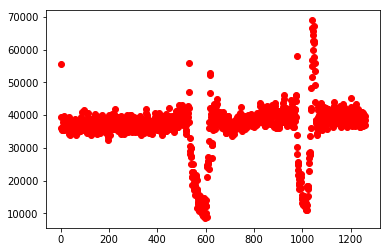

In [238]:
plt.plot(history_n_feat, 'ro')

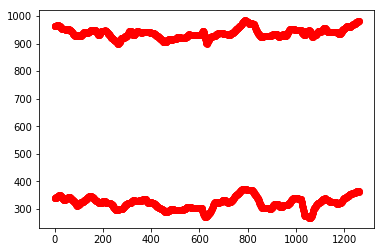

In [239]:
plt.plot(org_hist,'ro')

In [205]:
iteration = 1
left_coef = []
right_coef = []
history_n_feat = []
org_hist = []
flag_hist = []

output1 = 'test_videos_output_part2/PROJECT_NEW_FULL_3.mp4'

clip = VideoFileClip("project_video.mp4")#.subclip(19,26)

img_with_lanes = clip.fl_image(process_img) #NOTE: this function expects color images!!
#white_clip = clip1.fl_image(check_filters)
%time img_with_lanes.write_videofile(output1, audio=False)

clip.reader.close()
clip.audio.reader.close_proc()

[MoviePy] >>>> Building video test_videos_output_part2/PROJECT_NEW_FULL_3.mp4
[MoviePy] Writing video test_videos_output_part2/PROJECT_NEW_FULL_3.mp4



  8%|███                                    | 101/1261 [01:16<14:41,  1.32it/s]


 16%|██████▎                                | 203/1261 [02:34<13:08,  1.34it/s]


 24%|█████████▍                             | 305/1261 [03:56<13:58,  1.14it/s]


 32%|████████████▌                          | 407/1261 [05:17<10:39,  1.34it/s]


 40%|███████████████▋                       | 509/1261 [06:35<09:25,  1.33it/s]


 48%|██████████████████▉                    | 611/1261 [08:07<10:42,  1.01it/s]


 57%|██████████████████████                 | 713/1261 [09:32<07:21,  1.24it/s]


 65%|█████████████████████████▏             | 815/1261 [10:53<05:39,  1.31it/s]


 73%|████████████████████████████▎          | 917/1261 [12:12<04:29,  1.27it/s]


 81%|██████████████████████████████▋       | 1019/1261 [13:37<03:10,  1.27it/s]


 89%|█████████████████████████████████▊    | 1121/1261 [15:03<01:45,  1.33it/s]


 97%|████████████████████████████████████▊ | 1223/1261 [16:26<00:31,  1.20it/s]


100%|█████████████████████████████████████▉| 1260/1261 [16:56<00:00,  1.25it/s]


[MoviePy] Done.
[MoviePy] >>>> Video ready: test_videos_output_part2/PROJECT_NEW_FULL_3.mp4 

Wall time: 16min 58s


In [167]:
clip.reader.close()
clip.audio.reader.close_proc()

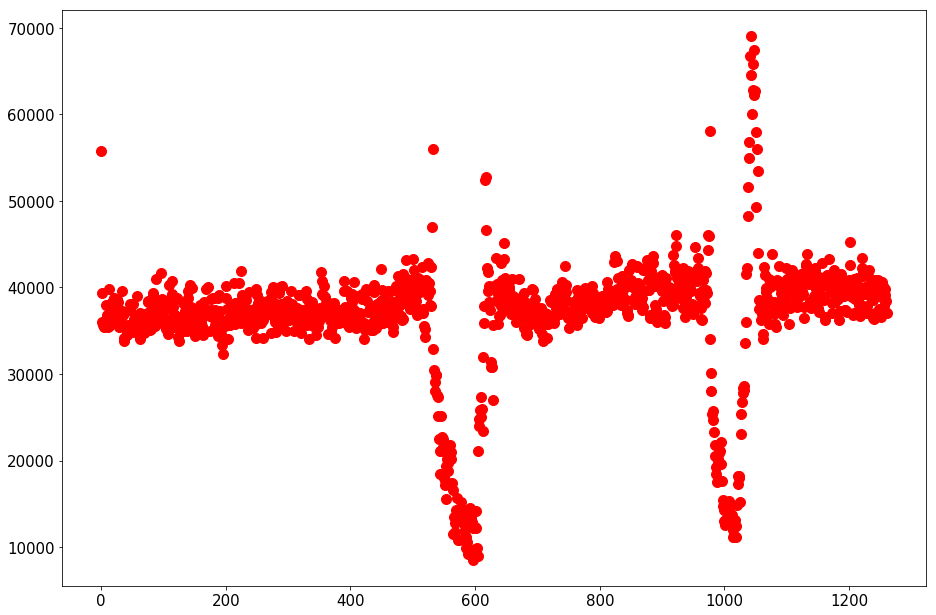

In [232]:
fig = plt.figure(figsize=(30,20))
ax1 = fig.add_axes([0.1, 0.3, 0.4, 0.4])
plt.plot(history_n_feat, 'ro', markersize=10)
for label in ax1.xaxis.get_ticklabels():
    label.set_fontsize(15)
for label in ax1.yaxis.get_ticklabels():
    label.set_fontsize(15)

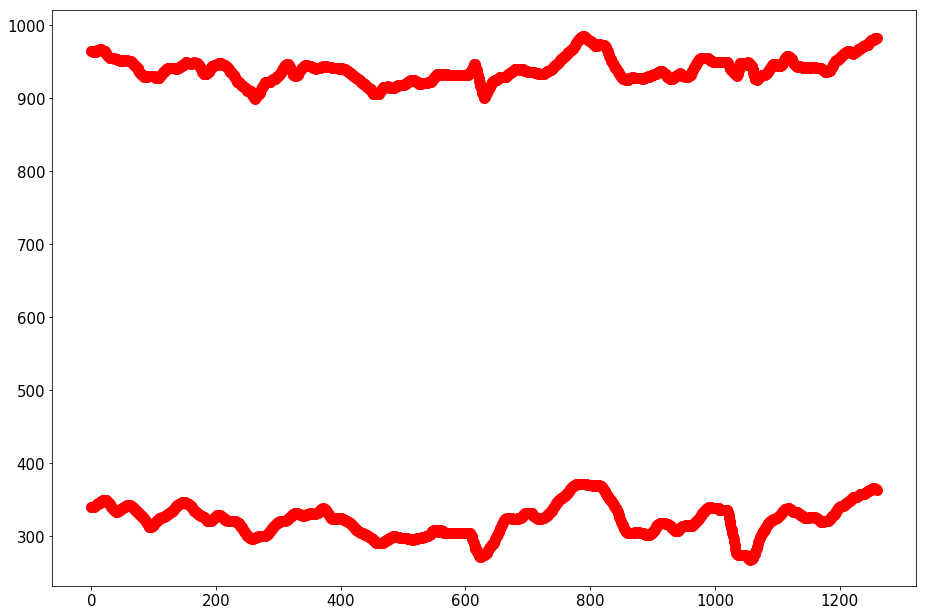

In [233]:
fig = plt.figure(figsize=(30,20))
ax1 = fig.add_axes([0.1, 0.3, 0.4, 0.4])
plt.plot(org_hist, 'ro', markersize=10)
for label in ax1.xaxis.get_ticklabels():
    label.set_fontsize(15)
for label in ax1.yaxis.get_ticklabels():
    label.set_fontsize(15)

Bad
26404


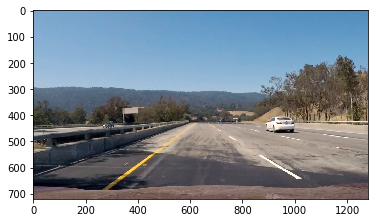

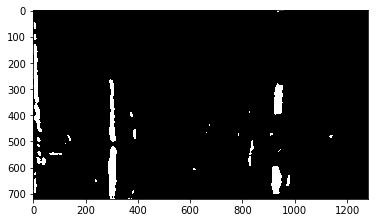

In [242]:
iteration = 1
left_coef = []
right_coef = []

output1 = 'test_videos_output_part2/test0001.mp4'
# n_feat = []
# for i in range(0,3):    
#     clip1 = VideoFileClip("challenge_video.mp4")#.subclip(0,0.2)
#     img = clip1.get_frame(i)

#     clip1.reader.close()
#     clip1.audio.reader.close_proc()

#     feat, flag, undist = pipeline(img)
#     n_feat.append(np.sum(feat))
    
#     fig, subfig = plt.subplots(1,2, figsize=(15,15))
#     subfig[0].imshow(img)
#     subfig[1].imshow(feat, cmap='gray')


clip1 = VideoFileClip("project_video.mp4")#.subclip(0,0.2)
img = clip1.get_frame(22)

clip1.reader.close()
clip1.audio.reader.close_proc()

plt.figure()
plt.imshow(img)
feat, flag, undist = pipeline(img)
print(flag)
print(np.sum(feat))
plt.figure()
plt.imshow(feat, 'gray')

[58039 60007 62188 62677 62750 64594 65795 66737 67418 69044]


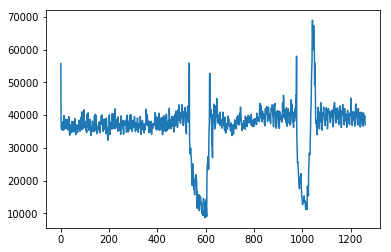

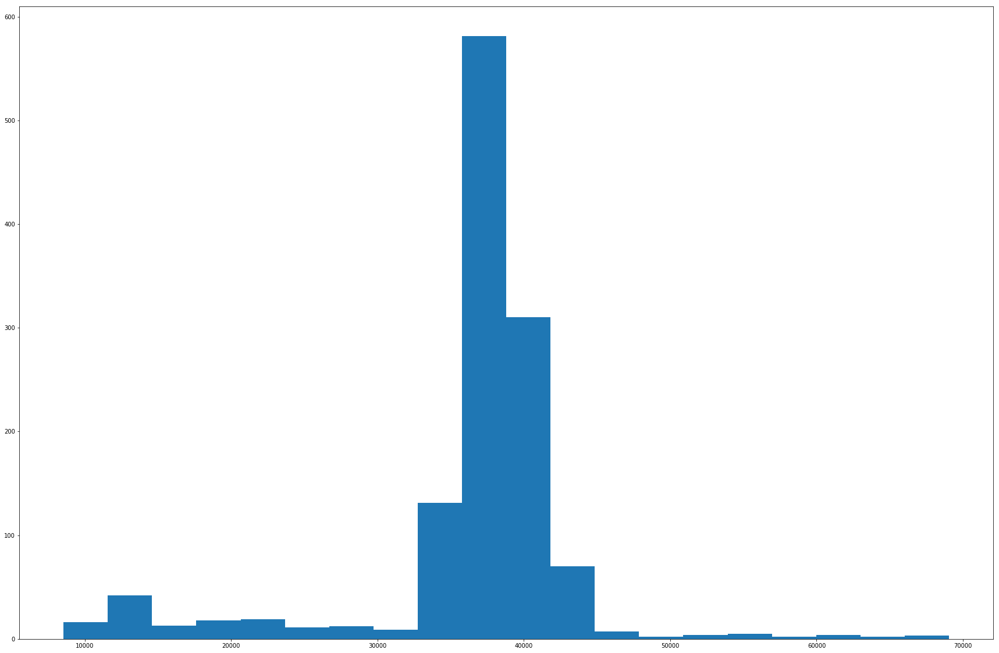

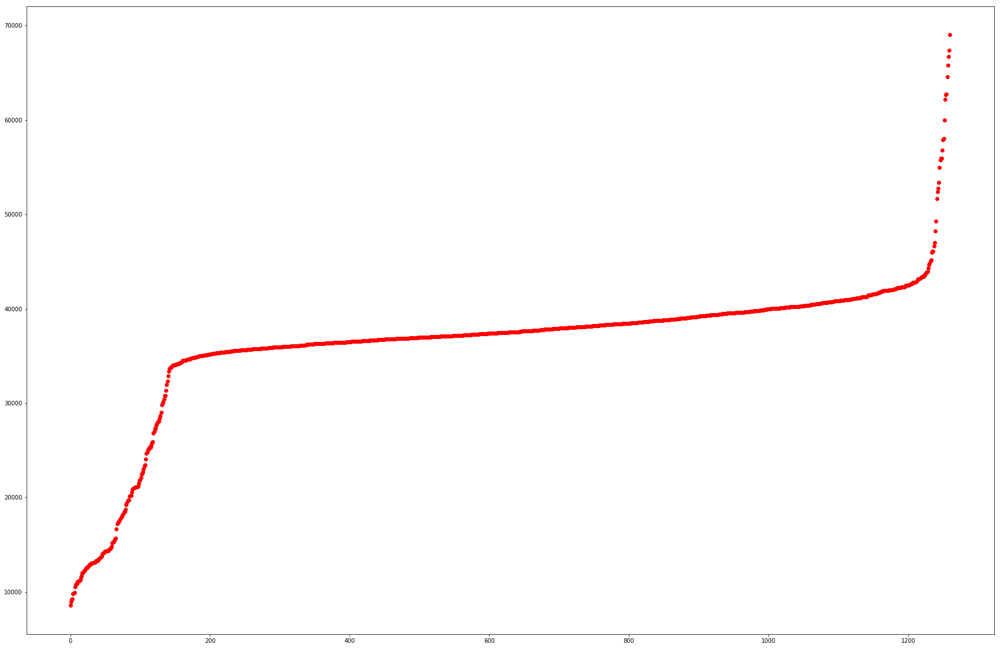

In [237]:
plt.plot(history_n_feat)
sorted_feat = np.sort(history_n_feat)
plt.figure(figsize=(30,20))
plt.hist(history_n_feat, 20)
plt.figure(figsize=(30,20))
plt.plot(sorted_feat, 'ro')
print(sorted_feat[-10:])
#print(n_feat[23])

In [21]:
# global variables, mostly for saving histories of parameter values
iteration  = 1
left_coef  = []
right_coef = []
belief_left = 1
belief_right = 1
belief_hist = [[1,1]]
org_center = (0,0)
start_center = (0,0)
my_right_fit = [0,0,0]
my_left_fit = [0,0,0]
left_hist = []
right_hist = []
left_fix = []
right_fix = []
org_hist = []
more_hist = []
more_hist2 = []
safe_lines_x = [0,0,0,0]
trust_l = []
trust_r = []

# Creating the Video

In [11]:
# Import everything needed to edit/save/watch video clips
from moviepy.editor import VideoFileClip
from moviepy.editor import *
from IPython.display import HTML
import cv2
import numpy as np

[MoviePy] >>>> Building video test_videos_output_part2/test0.mp4
[MoviePy] Writing video test_videos_output_part2/test0.mp4


 83%|████████████████████████████████████▋       | 5/6 [00:07<00:01,  1.45s/it]


[MoviePy] Done.
[MoviePy] >>>> Video ready: test_videos_output_part2/test0.mp4 

Wall time: 8.64 s


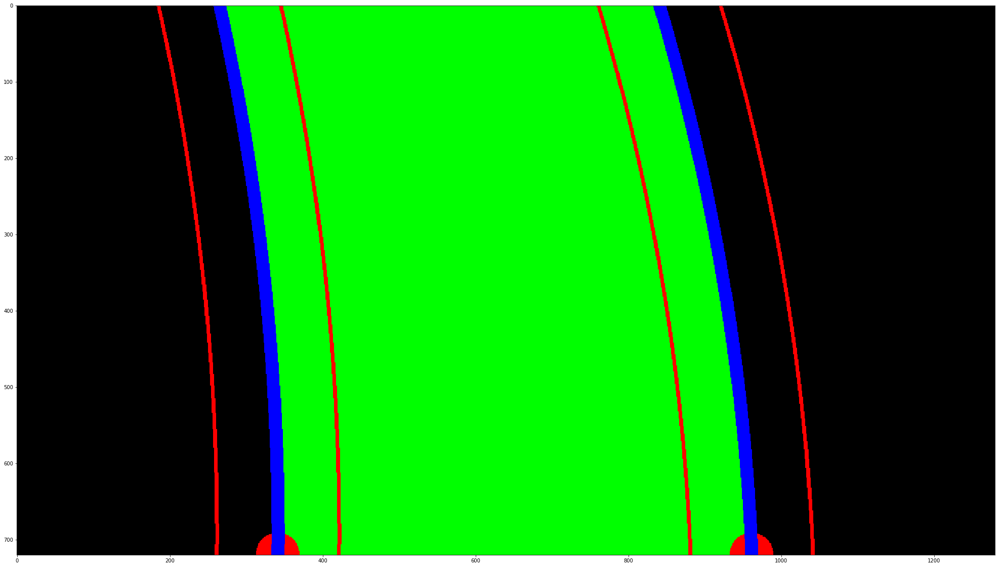

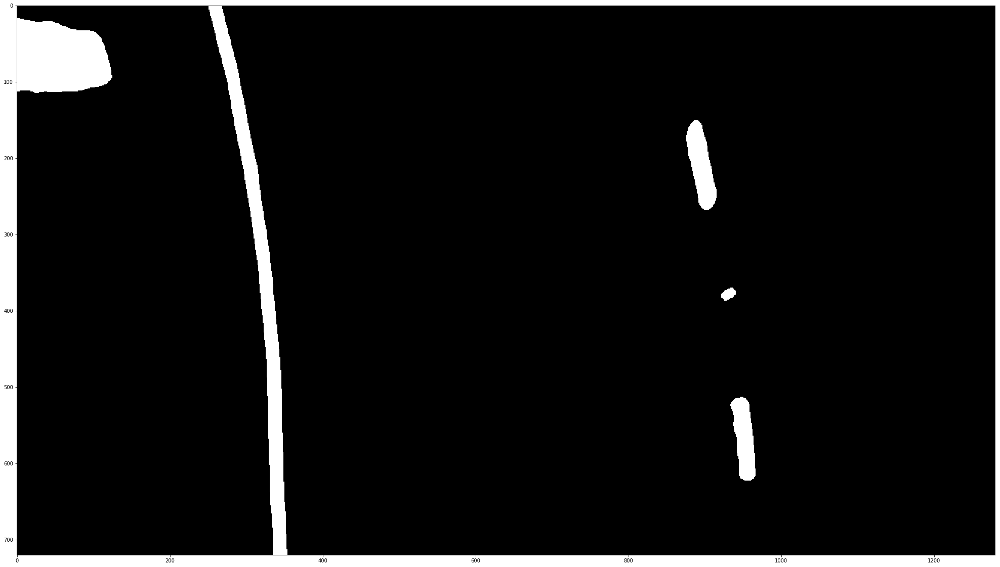

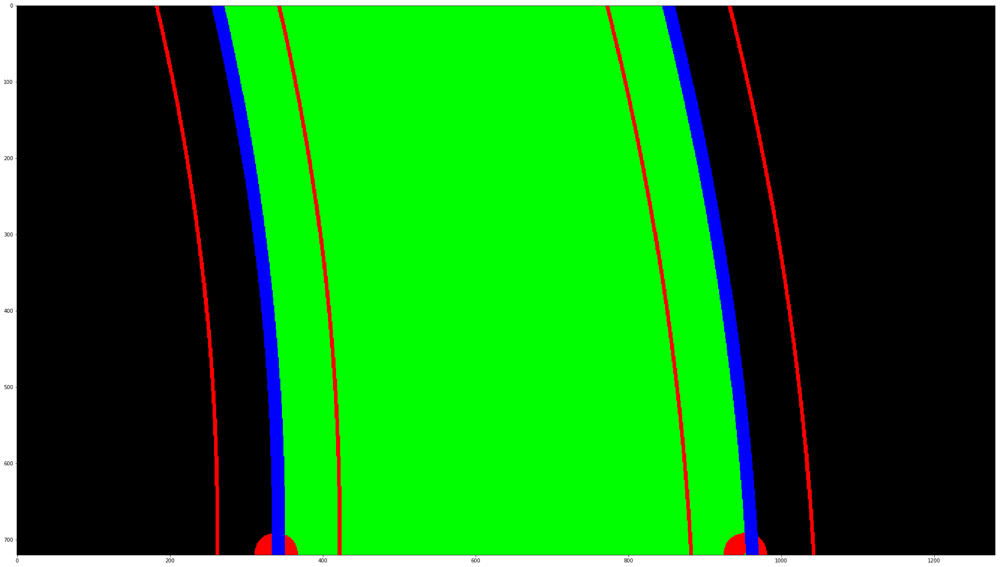

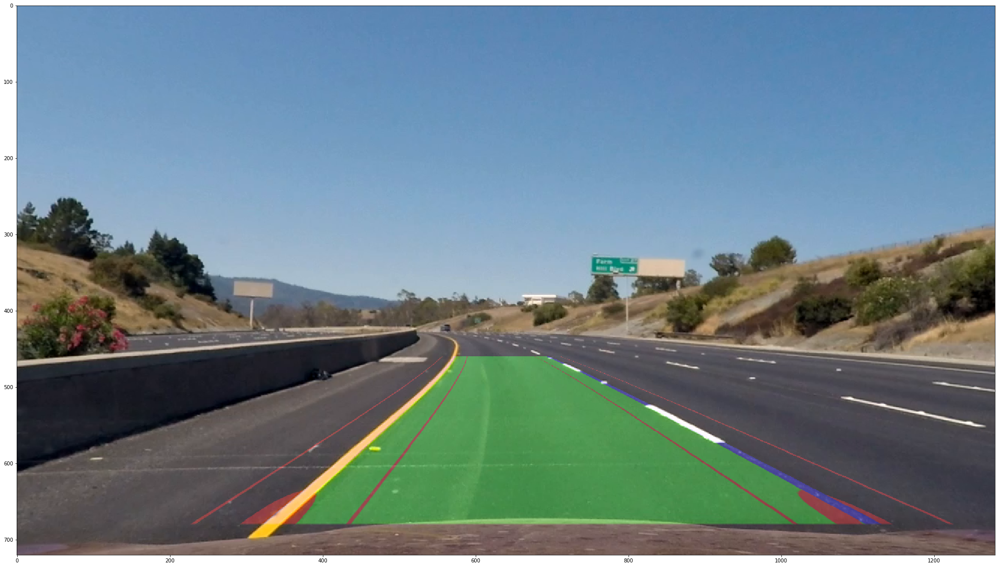

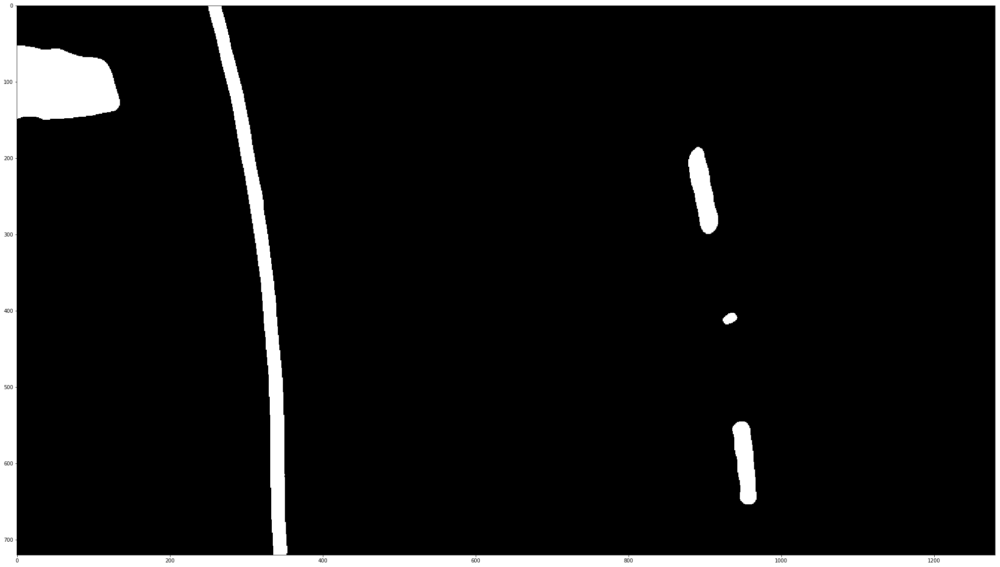

...

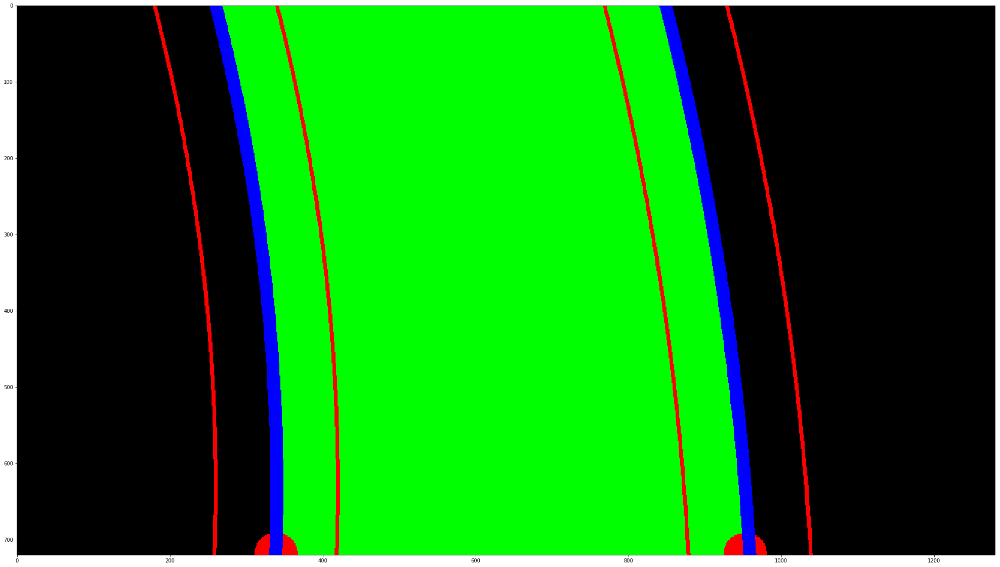

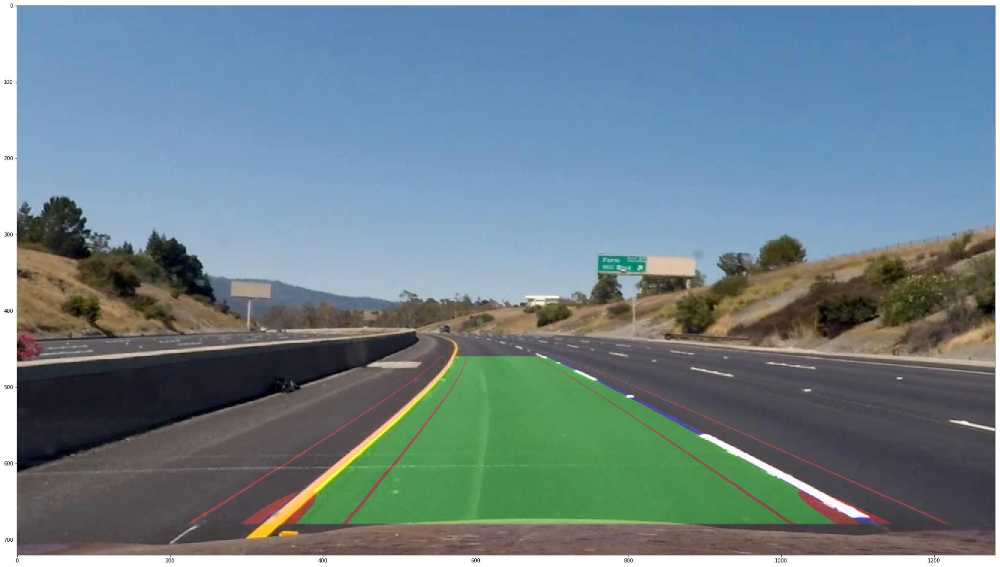

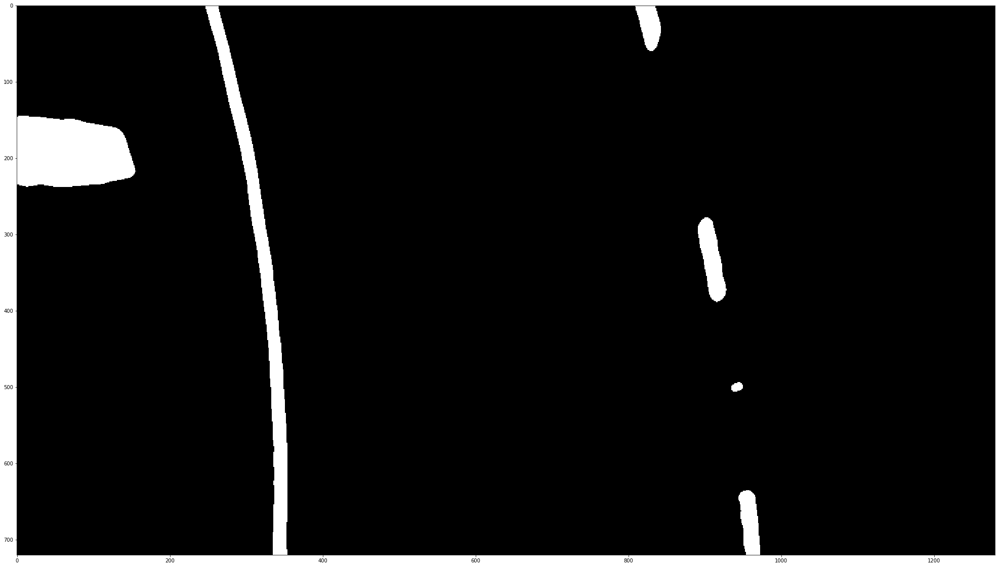

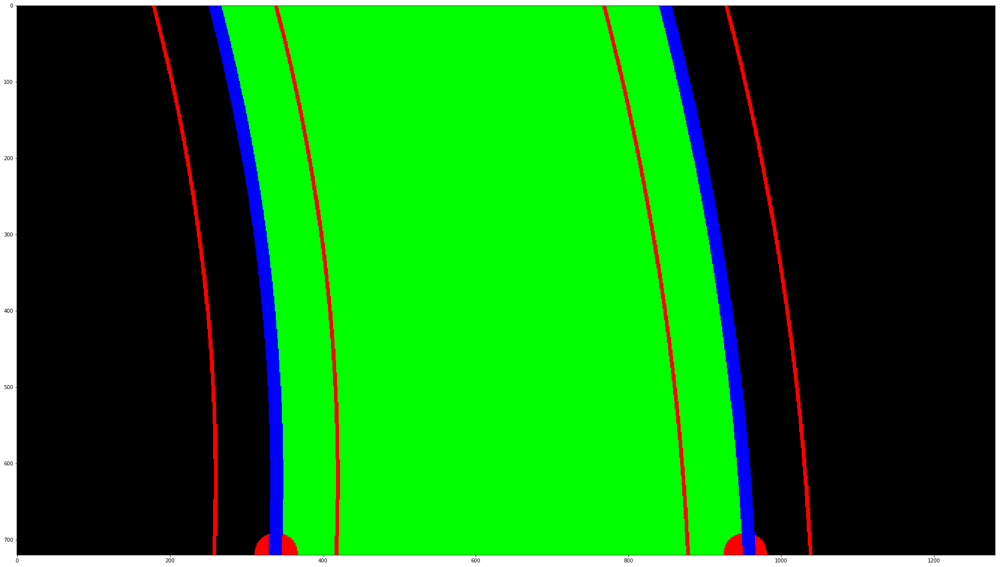

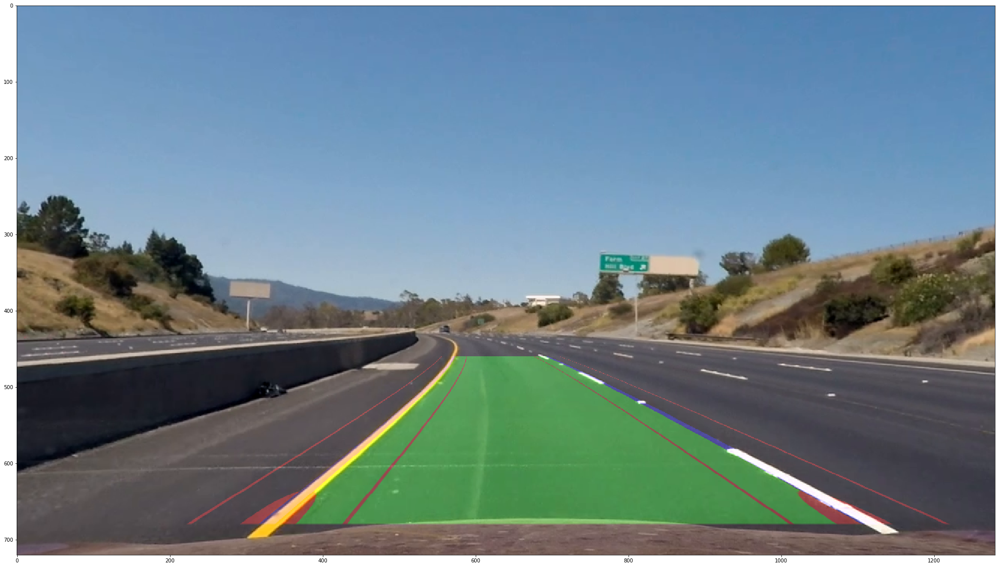

In [22]:
output1 = 'test_videos_output_part2/test0.mp4'

clip1 = VideoFileClip("project_video.mp4").subclip(0,0.2)

white_clip = clip1.fl_image(process_img2) #NOTE: this function expects color images!!
#white_clip = clip1.fl_image(check_filters)
%time white_clip.write_videofile(output1, audio=False)

clip1.reader.close()
clip1.audio.reader.close_proc()

In [241]:
clip1.reader.close()
clip1.audio.reader.close_proc()